# Tennis Object Detection with YOLO and Slicing
This notebook demonstrates two detection approaches using a custom YOLO model:
- **Normal detection** on the full image
- **Sliced detection** to improve accuracy for small objects like tennis balls


In [3]:
import os
import cv2
import numpy as np
from ultralytics import YOLO
import supervision as sv

import pandas as pd
import matplotlib.pyplot as plt
from collections import defaultdict
import random
from pathlib import Path
%pip install scikit-learn


Note: you may need to restart the kernel to use updated packages.


In [2]:
# Create output directory
os.makedirs("outputs", exist_ok=True)


In [3]:
def detect_normal(image_path, model_path="model/model1.pt", conf=0.1):
    model = YOLO(model_path)
    results = model.predict(source=image_path, conf=conf, save=True)

    for result in results:
        print("Detected classes:", result.names)
        print("Detected boxes:")
        for box in result.boxes:
            print(box)

        detections = sv.Detections.from_ultralytics(result)
        image = cv2.imread(image_path)

        labels = [
            f"{result.names[class_id]} {confidence:.2f}"
            for class_id, confidence in zip(detections.class_id, detections.confidence)
        ]

        box_annotator = sv.BoxAnnotator()
        label_annotator = sv.LabelAnnotator()

        annotated_image = box_annotator.annotate(scene=image, detections=detections)
        annotated_image = label_annotator.annotate(scene=annotated_image, detections=detections, labels=labels)

        cv2.imwrite("outputs/normal_output.jpg", annotated_image)
        return annotated_image  # Optional: to show in notebook


In [4]:
def detect_with_slicing(image_path, model_path="model/model1.pt", slice_size=(384, 384), stride=(320, 320)):
    image = cv2.imread(image_path)
    model = YOLO(model_path)
    height, width, _ = image.shape
    all_detections = []

    for y in range(0, height, stride[1]):
        for x in range(0, width, stride[0]):
            x_end = min(x + slice_size[0], width)
            y_end = min(y + slice_size[1], height)
            image_slice = image[y:y_end, x:x_end]
            results = model.predict(image_slice, conf=0.1)
            result = results[0]

            detections = sv.Detections.from_ultralytics(result)
            detections.xyxy[:, [0, 2]] += x
            detections.xyxy[:, [1, 3]] += y

            all_detections.append(detections)

    final_detections = sv.Detections.merge(all_detections)
    print("Total detections (with slicing):", len(final_detections.xyxy))

    labels = [
        f"{model.model.names[class_id]} {confidence:.2f}"
        for class_id, confidence in zip(final_detections.class_id, final_detections.confidence)
    ]

    box_annotator = sv.BoxAnnotator()
    label_annotator = sv.LabelAnnotator()
    annotated_image = box_annotator.annotate(scene=image, detections=final_detections)
    annotated_image = label_annotator.annotate(scene=annotated_image, detections=final_detections, labels=labels)

    cv2.imwrite("outputs/sliced_output.jpg", annotated_image)
    return annotated_image  # Optional: to show in notebook


In [5]:
image_path = "data/frames/video5/frame_0014.jpg"

# Run normal detection
output_normal = detect_normal(image_path)

# Run detection with slicing
output_sliced = detect_with_slicing(image_path)



image 1/1 c:\Users\benna\OneDrive\Desktop\MASTER\Semester 2\Dissertation\TRABAJO DEFINITIVO\amateur-tennis-cv-system\data\frames\video5\frame_0014.jpg: 384x640 1 player, 110.7ms
Speed: 3.9ms preprocess, 110.7ms inference, 5.9ms postprocess per image at shape (1, 3, 384, 640)
Results saved to C:\Users\benna\OneDrive\Desktop\MASTER\Semester 2\Dissertation\TRABAJO DEFINITIVO\amateur-tennis-cv-system\runs\detect\predict6
Detected classes: {0: 'ball', 1: 'player'}
Detected boxes:
ultralytics.engine.results.Boxes object with attributes:

cls: tensor([1.])
conf: tensor([0.6845])
data: tensor([[1.1949e+03, 6.3634e+02, 1.3365e+03, 9.5934e+02, 6.8445e-01, 1.0000e+00]])
id: None
is_track: False
orig_shape: (1080, 1920)
shape: torch.Size([1, 6])
xywh: tensor([[1265.7393,  797.8420,  141.6035,  322.9971]])
xywhn: tensor([[0.6592, 0.7387, 0.0738, 0.2991]])
xyxy: tensor([[1194.9375,  636.3435, 1336.5410,  959.3406]])
xyxyn: tensor([[0.6224, 0.5892, 0.6961, 0.8883]])

0: 640x640 (no detections), 94.6

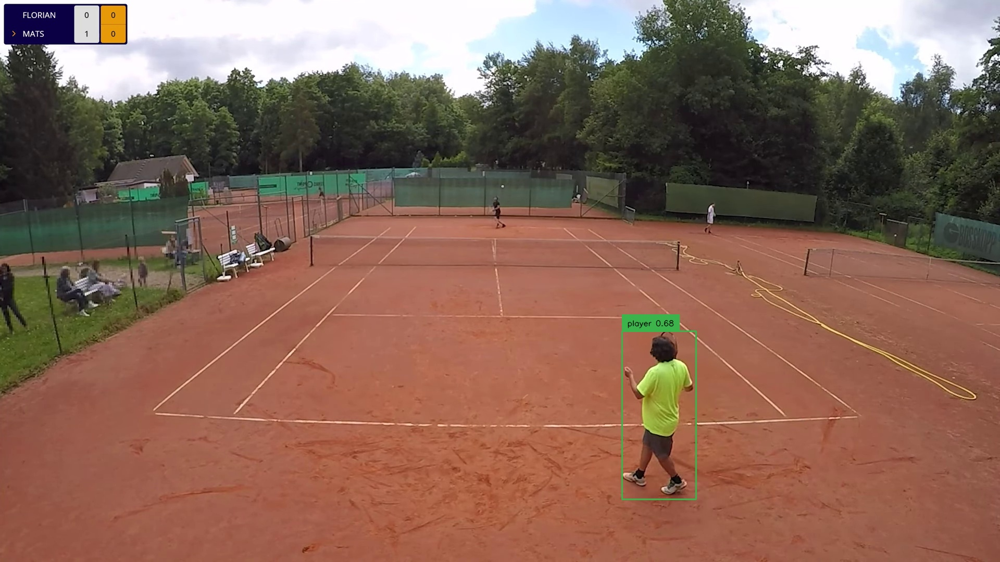

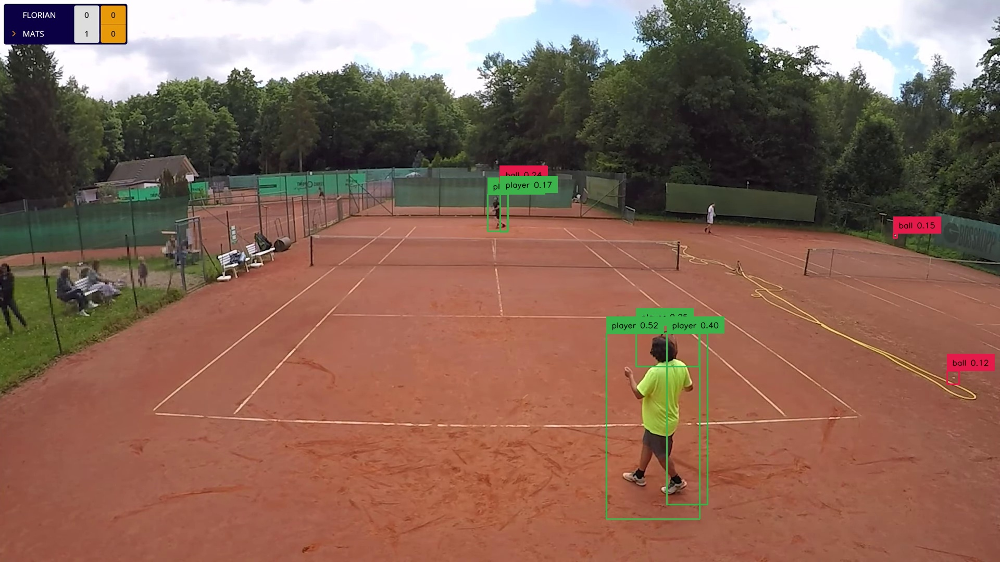

In [6]:
from IPython.display import Image, display

display(Image(filename="outputs/normal_output.jpg"))
display(Image(filename="outputs/sliced_output.jpg"))


## Next Step: Evaluate Best Slice Size

In [7]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from ultralytics import YOLO
import supervision as sv
from collections import defaultdict
import pandas as pd


MODEL_PATH = "model/model1.pt"
slice_sizes = [(128, 128), (256, 256), (384, 384), (512, 512), (640, 640)]
stride_ratio = 0.8
conf_threshold = 0.1


In [8]:
def evaluate_slice_sizes_multiple(images, model_path, slice_sizes):
    model = YOLO(model_path)
    results_dict = defaultdict(list)

    for slice_w, slice_h in slice_sizes:
        stride_w = int(slice_w * stride_ratio)
        stride_h = int(slice_h * stride_ratio)

        total_ball = 0
        total_player = 0

        for image_path in images:
            image = cv2.imread(image_path)
            if image is None:
                print(f"Warning: Image not found: {image_path}")
                continue

            height, width, _ = image.shape
            all_detections = []

            for y in range(0, height, stride_h):
                for x in range(0, width, stride_w):
                    x_end = min(x + slice_w, width)
                    y_end = min(y + slice_h, height)
                    image_slice = image[y:y_end, x:x_end]

                    results = model.predict(image_slice, conf=conf_threshold, verbose=False)
                    result = results[0]
                    detections = sv.Detections.from_ultralytics(result)
                    detections.xyxy[:, [0, 2]] += x
                    detections.xyxy[:, [1, 3]] += y
                    all_detections.append(detections)

            final_detections = sv.Detections.merge(all_detections)
            class_ids = final_detections.class_id
            class_names = [model.model.names[i] for i in class_ids]
            count_by_class = pd.Series(class_names).value_counts().to_dict()

            total_ball += count_by_class.get("ball", 0)
            total_player += count_by_class.get("player", 0)

        results_dict["slice_size"].append(f"{slice_w}x{slice_h}")
        results_dict["ball"].append(total_ball)
        results_dict["player"].append(total_player)

    return pd.DataFrame(results_dict)


In [9]:
import os
import random

# Ruta base
base_dir = "data/frames"

# Buscar todas las imágenes en todos los subdirectorios
all_images = []
for root, _, files in os.walk(base_dir):
    for file in files:
        if file.endswith((".jpg", ".png", ".jpeg")):
            full_path = os.path.join(root, file)
            all_images.append(full_path)

# Seleccionar 10 imágenes aleatorias
test_images = random.sample(all_images, 10)

# Mostrar rutas seleccionadas
print("Imágenes seleccionadas aleatoriamente:")
for img in test_images:
    print("-", img)


Imágenes seleccionadas aleatoriamente:
- data/frames\video1\frame_0126.jpg
- data/frames\video6\frame_0142.jpg
- data/frames\video2\frame_0360.jpg
- data/frames\video2\frame_0299.jpg
- data/frames\video6\frame_0126.jpg
- data/frames\video3\frame_0021.jpg
- data/frames\video1\frame_0029.jpg
- data/frames\videoTest\frame_0013.jpg
- data/frames\video6\frame_0001.jpg
- data/frames\video1\frame_0256.jpg


C:\Users\benna\AppData\Local\Temp\ipykernel_15912\2956546757.py:12: UserWarning: Glyph 127934 (\N{TENNIS RACQUET AND BALL}) missing from current font.
  plt.tight_layout()
C:\Users\benna\AppData\Local\Temp\ipykernel_15912\2956546757.py:12: UserWarning: Glyph 129485 (\N{STANDING PERSON}) missing from current font.
  plt.tight_layout()
c:\Users\benna\OneDrive\Desktop\MASTER\Semester 2\Dissertation\TRABAJO DEFINITIVO\amateur-tennis-cv-system\venv\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 127934 (\N{TENNIS RACQUET AND BALL}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
c:\Users\benna\OneDrive\Desktop\MASTER\Semester 2\Dissertation\TRABAJO DEFINITIVO\amateur-tennis-cv-system\venv\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 129485 (\N{STANDING PERSON}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


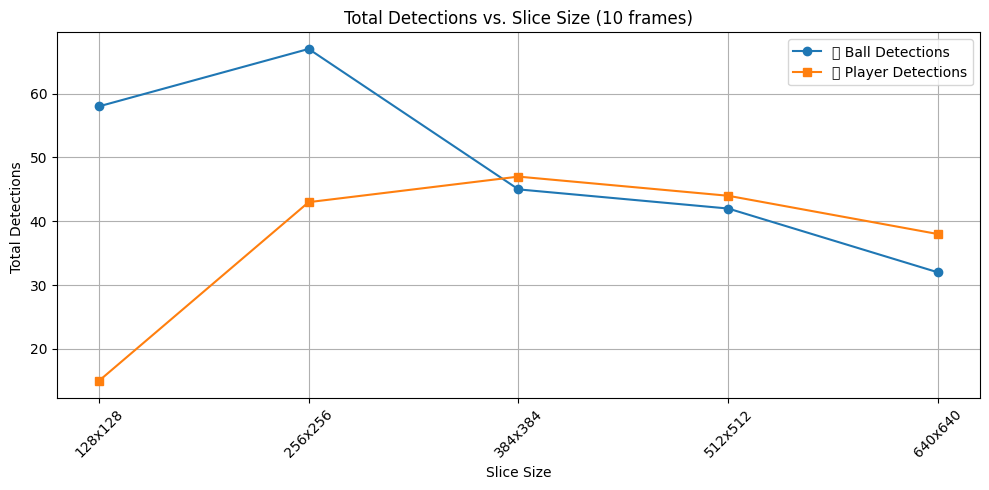

,slice_size,ball,player
0,128x128,58,15
1,256x256,67,43
2,384x384,45,47
3,512x512,42,44
4,640x640,32,38


In [19]:
df_results = evaluate_slice_sizes_multiple(test_images, MODEL_PATH, slice_sizes)

plt.figure(figsize=(10, 5))
plt.plot(df_results["slice_size"], df_results["ball"], label="🎾 Ball Detections", marker='o')
plt.plot(df_results["slice_size"], df_results["player"], label="🧍 Player Detections", marker='s')
plt.title("Total Detections vs. Slice Size (10 frames)")
plt.xlabel("Slice Size")
plt.ylabel("Total Detections ")
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

df_results


## CONCLUSION: BEST SLICE_SIZE is 256 x 256

In [10]:
import os
import random
import cv2
import numpy as np
import matplotlib.pyplot as plt
from ultralytics import YOLO
import supervision as sv

# Config
IMAGE_FOLDER = "data/frames/"
MODEL_PATH = "model/model1.pt"
SLICE_SIZE = (256, 256)
STRIDE_RATIO = 0.8
CONF_THRESHOLD = 0.1
N_IMAGES = 10

def get_random_images(folder, n=10):
    image_paths = []
    for root, dirs, files in os.walk(folder):
        for file in files:
            if file.endswith((".jpg", ".png")):
                image_paths.append(os.path.join(root, file))
    return random.sample(image_paths, min(n, len(image_paths)))



0: 640x640 1 player, 80.0ms
Speed: 3.4ms preprocess, 80.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 49.8ms
Speed: 2.7ms preprocess, 49.8ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 47.8ms
Speed: 2.5ms preprocess, 47.8ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 48.0ms
Speed: 2.5ms preprocess, 48.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 51.9ms
Speed: 2.4ms preprocess, 51.9ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 47.9ms
Speed: 2.5ms preprocess, 47.9ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 players, 53.8ms
Speed: 2.5ms preprocess, 53.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 56.6ms
Speed: 3.1ms preprocess, 56.6ms inference, 0.5

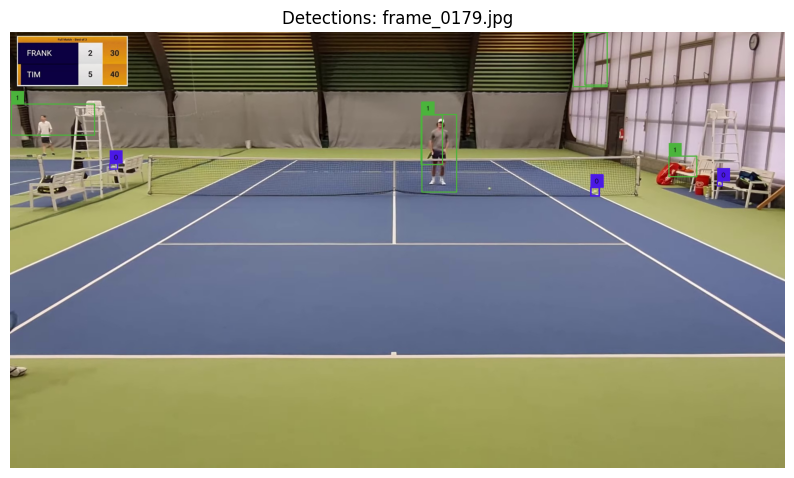


0: 640x640 (no detections), 90.9ms
Speed: 2.9ms preprocess, 90.9ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 54.3ms
Speed: 2.6ms preprocess, 54.3ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 53.4ms
Speed: 2.8ms preprocess, 53.4ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 ball, 56.0ms
Speed: 2.5ms preprocess, 56.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 54.2ms
Speed: 2.9ms preprocess, 54.2ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 53.2ms
Speed: 2.8ms preprocess, 53.2ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 player, 55.7ms
Speed: 2.5ms preprocess, 55.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 55.9ms
Speed: 2.4ms preprocess, 55.9ms inference, 0.4ms 

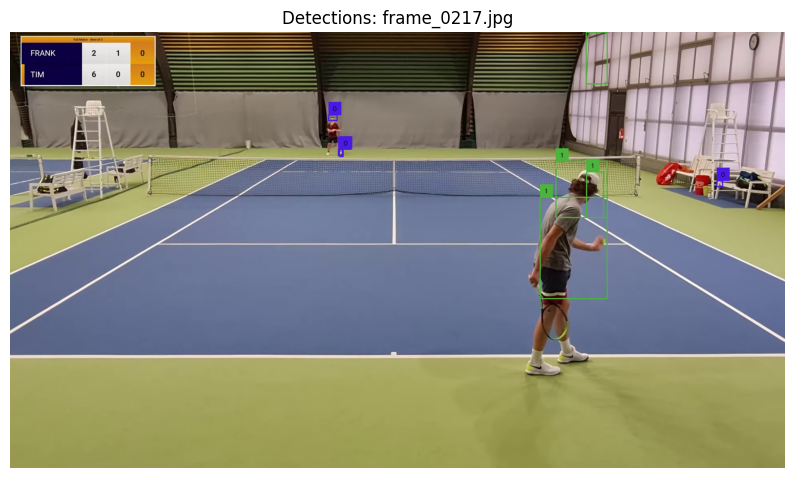


0: 640x640 1 player, 77.1ms
Speed: 2.9ms preprocess, 77.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 51.0ms
Speed: 2.4ms preprocess, 51.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 51.1ms
Speed: 3.1ms preprocess, 51.1ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 50.2ms
Speed: 2.4ms preprocess, 50.2ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 50.0ms
Speed: 2.5ms preprocess, 50.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 52.0ms
Speed: 3.5ms preprocess, 52.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 players, 50.6ms
Speed: 2.6ms preprocess, 50.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 50.7ms
Speed: 2.5ms preprocess, 50.7ms inference, 0.6

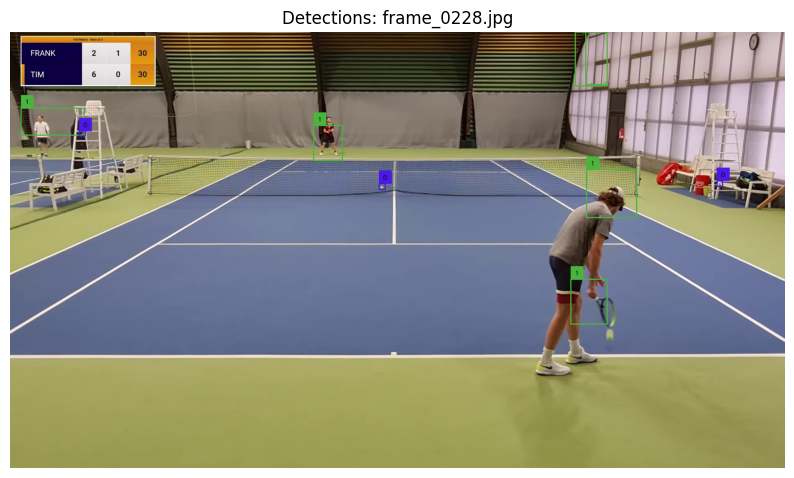


0: 640x640 1 ball, 91.6ms
Speed: 2.5ms preprocess, 91.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 60.3ms
Speed: 2.4ms preprocess, 60.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 4 balls, 60.0ms
Speed: 2.5ms preprocess, 60.0ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 balls, 51.1ms
Speed: 2.5ms preprocess, 51.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 50.5ms
Speed: 2.5ms preprocess, 50.5ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 balls, 1 player, 50.1ms
Speed: 2.9ms preprocess, 50.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 4 balls, 49.7ms
Speed: 2.3ms preprocess, 49.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 50.8ms
Speed: 2.3ms preprocess, 50.8ms inference, 0.4ms postprocess per

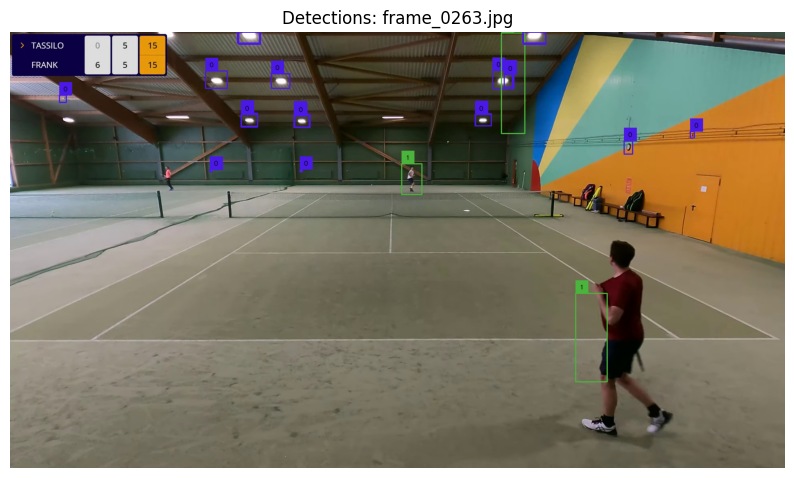


0: 640x640 (no detections), 85.6ms
Speed: 3.4ms preprocess, 85.6ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 61.1ms
Speed: 2.7ms preprocess, 61.1ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 59.0ms
Speed: 2.3ms preprocess, 59.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 62.0ms
Speed: 2.4ms preprocess, 62.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 48.5ms
Speed: 2.7ms preprocess, 48.5ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 50.0ms
Speed: 2.4ms preprocess, 50.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 53.4ms
Speed: 2.6ms preprocess, 53.4ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 49.5ms
Speed: 2.3ms preprocess, 49.5ms i

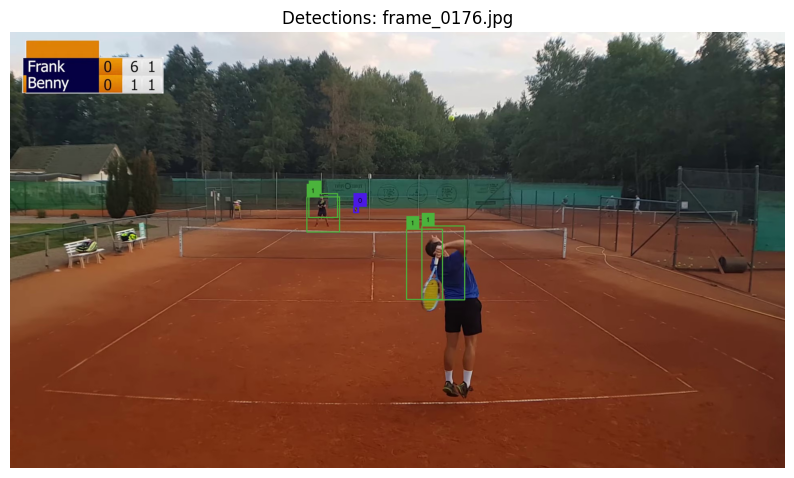


0: 640x640 (no detections), 84.3ms
Speed: 3.1ms preprocess, 84.3ms inference, 0.3ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 51.7ms
Speed: 2.4ms preprocess, 51.7ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 53.7ms
Speed: 3.6ms preprocess, 53.7ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 51.9ms
Speed: 2.4ms preprocess, 51.9ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 52.3ms
Speed: 3.7ms preprocess, 52.3ms inference, 0.3ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 52.3ms
Speed: 2.6ms preprocess, 52.3ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 3 balls, 54.2ms
Speed: 2.7ms preprocess, 54.2ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 ball, 52.8ms
Speed: 2.4ms preprocess, 52.8ms inference, 0.6ms p

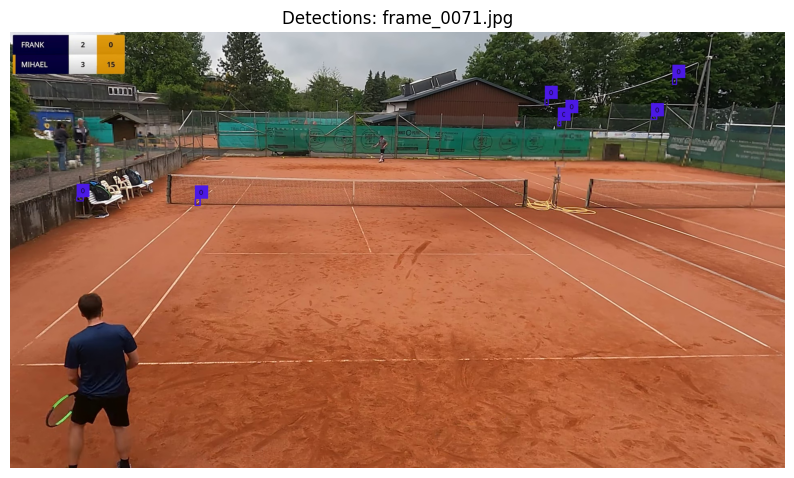


0: 640x640 (no detections), 82.5ms
Speed: 2.7ms preprocess, 82.5ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 53.0ms
Speed: 2.4ms preprocess, 53.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 53.0ms
Speed: 2.4ms preprocess, 53.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 54.7ms
Speed: 2.6ms preprocess, 54.7ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 72.9ms
Speed: 2.5ms preprocess, 72.9ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 47.8ms
Speed: 3.2ms preprocess, 47.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 ball, 53.7ms
Speed: 2.4ms preprocess, 53.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 3 balls, 48.0ms
Speed: 2.3ms preprocess, 48.0ms inference, 0.6ms p

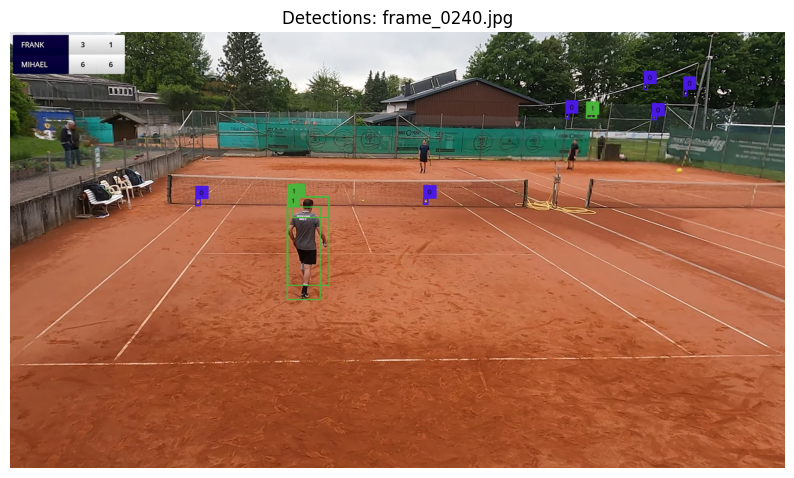


0: 640x640 (no detections), 80.2ms
Speed: 3.2ms preprocess, 80.2ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 48.7ms
Speed: 2.2ms preprocess, 48.7ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 52.8ms
Speed: 2.4ms preprocess, 52.8ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 51.7ms
Speed: 2.4ms preprocess, 51.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 57.4ms
Speed: 2.4ms preprocess, 57.4ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 54.5ms
Speed: 3.0ms preprocess, 54.5ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 57.5ms
Speed: 2.9ms preprocess, 57.5ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 56.3ms
Speed: 2.6ms preprocess, 56.3ms i

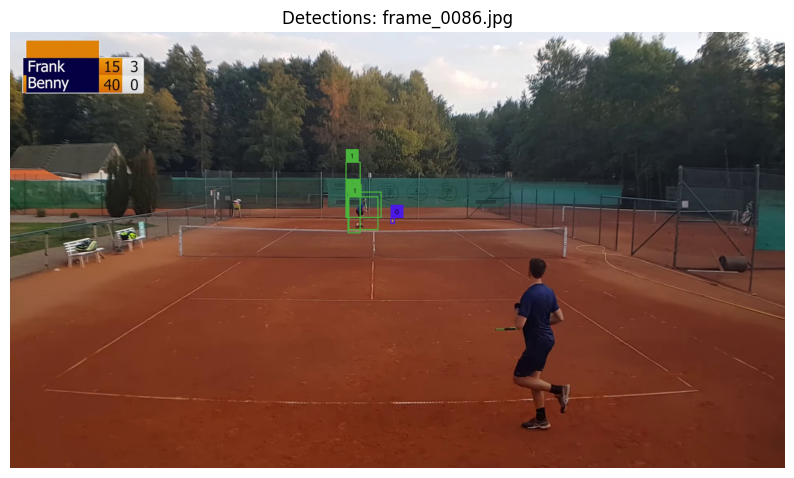


0: 640x640 (no detections), 91.3ms
Speed: 3.1ms preprocess, 91.3ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 49.9ms
Speed: 2.3ms preprocess, 49.9ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 3 balls, 51.3ms
Speed: 2.4ms preprocess, 51.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 balls, 48.2ms
Speed: 3.1ms preprocess, 48.2ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 46.9ms
Speed: 2.3ms preprocess, 46.9ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 balls, 1 player, 48.1ms
Speed: 2.3ms preprocess, 48.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 balls, 48.1ms
Speed: 2.5ms preprocess, 48.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 47.5ms
Speed: 2.5ms preprocess, 47.5ms inference, 0.4ms postpr

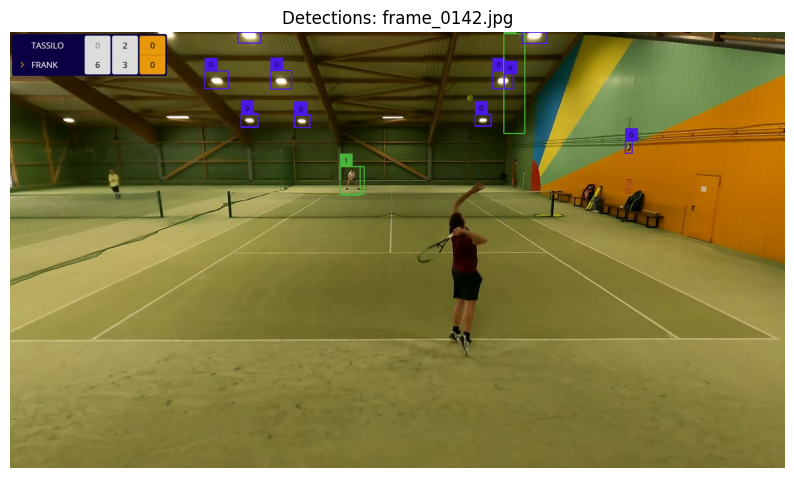


0: 640x640 (no detections), 90.0ms
Speed: 3.2ms preprocess, 90.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 ball, 47.3ms
Speed: 2.4ms preprocess, 47.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 63.0ms
Speed: 2.8ms preprocess, 63.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 49.6ms
Speed: 2.9ms preprocess, 49.6ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 46.9ms
Speed: 2.4ms preprocess, 46.9ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 47.4ms
Speed: 2.3ms preprocess, 47.4ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 47.4ms
Speed: 2.3ms preprocess, 47.4ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 47.1ms
Speed: 2.3ms preprocess, 47.1ms inference,

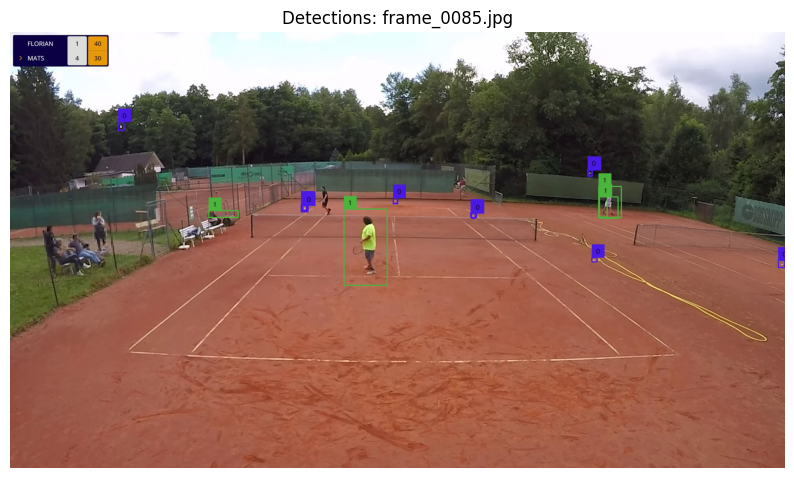

In [11]:
def run_inference_on_images(image_paths, model_path, slice_size=(256,256), conf=0.1):
    model = YOLO(model_path)
    w_slice, h_slice = slice_size
    stride_w = int(w_slice * STRIDE_RATIO)
    stride_h = int(h_slice * STRIDE_RATIO)

    for path in image_paths:
        image = cv2.imread(path)
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        h_img, w_img, _ = image.shape
        detections_all = []

        for y in range(0, h_img, stride_h):
            for x in range(0, w_img, stride_w):
                x_end = min(x + w_slice, w_img)
                y_end = min(y + h_slice, h_img)
                slice_img = image[y:y_end, x:x_end]
                results = model.predict(slice_img, conf=conf)
                result = results[0]
                det = sv.Detections.from_ultralytics(result)
                det.xyxy[:, [0, 2]] += x
                det.xyxy[:, [1, 3]] += y
                detections_all.append(det)

        detections_merged = sv.Detections.merge(detections_all)
        annotator = sv.BoxAnnotator()
        annotated_img = annotator.annotate(scene=image_rgb.copy(), detections=detections_merged)
        plt.figure(figsize=(10, 6))
        plt.imshow(annotated_img)
        plt.title(f"Detections: {os.path.basename(path)}")
        plt.axis('off')
        plt.show()

# Execute
random_imgs = get_random_images(IMAGE_FOLDER, N_IMAGES)
run_inference_on_images(random_imgs, MODEL_PATH, slice_size=SLICE_SIZE, conf=CONF_THRESHOLD)


In [14]:

MODEL_PATH = "model/model1.pt"
SLICE_SIZES = [(128, 128), (256, 256), (384, 384), (512, 512), (640, 640)]
STRIDE_RATIO = 0.8
CONF_THRESHOLD = 0.1

# Obtener imágenes aleatorias
def get_random_images_from_folder(folder_path, n=10):
    all_images = list(Path(folder_path).rglob("*.jpg"))
    return random.sample(all_images, min(n, len(all_images)))


# Evaluar precisión
def evaluate_precision_slice_sizes(image_paths, model_path, slice_sizes):
    model = YOLO(model_path)
    precision_data = []

    for slice_w, slice_h in slice_sizes:
        stride_w = int(slice_w * STRIDE_RATIO)
        stride_h = int(slice_h * STRIDE_RATIO)
        total_tp = 0
        total_fp = 0

        for img_path in image_paths:
            image = cv2.imread(str(img_path))
            if image is None:
                continue
            height, width, _ = image.shape
            all_detections = []

            for y in range(0, height, stride_h):
                for x in range(0, width, stride_w):
                    x_end = min(x + slice_w, width)
                    y_end = min(y + slice_h, height)
                    image_slice = image[y:y_end, x:x_end]
                    results = model.predict(image_slice, conf=CONF_THRESHOLD)
                    result = results[0]
                    detections = sv.Detections.from_ultralytics(result)
                    detections.xyxy[:, [0, 2]] += x
                    detections.xyxy[:, [1, 3]] += y
                    all_detections.append(detections)

            merged = sv.Detections.merge(all_detections)

            # Asumimos: conf > 0.3 = TP, conf < 0.3 = FP
            for class_id, conf in zip(merged.class_id, merged.confidence):
                name = model.model.names[class_id]
                if name == "ball":
                    if conf > 0.3:
                        total_tp += 1
                    else:
                        total_fp += 1

        precision = total_tp / (total_tp + total_fp + 1e-6)
        precision_data.append({
            "slice_size": f"{slice_w}x{slice_h}",
            "TP": total_tp,
            "FP": total_fp,
            "Precision": round(precision, 3)
        })

    return pd.DataFrame(precision_data)



0: 640x640 (no detections), 61.5ms
Speed: 2.6ms preprocess, 61.5ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 54.5ms
Speed: 2.6ms preprocess, 54.5ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 47.9ms
Speed: 2.2ms preprocess, 47.9ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 47.6ms
Speed: 2.3ms preprocess, 47.6ms inference, 0.3ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 48.1ms
Speed: 2.4ms preprocess, 48.1ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 48.0ms
Speed: 2.4ms preprocess, 48.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 47.9ms
Speed: 2.4ms preprocess, 47.9ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 49.5ms
Speed: 2.3ms preprocess, 49.5ms i

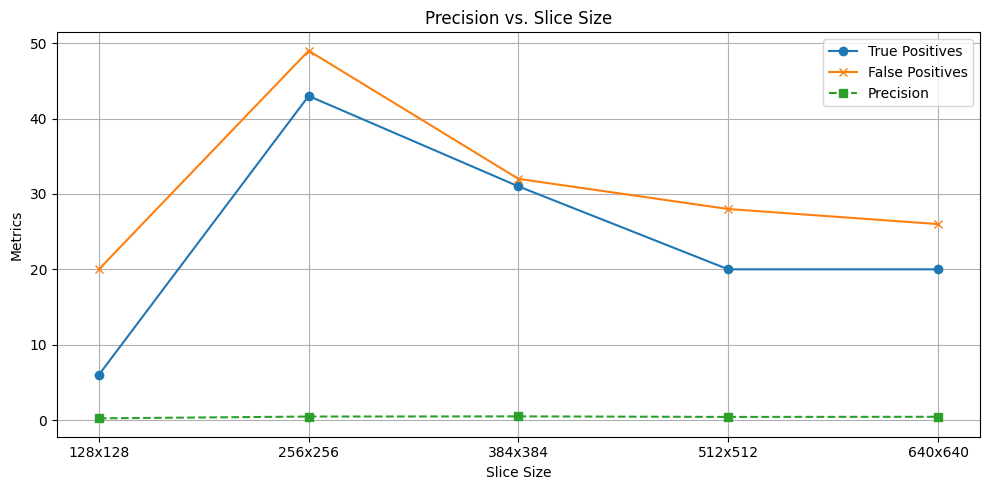

In [15]:
# Cargar imágenes aleatorias de tu dataset
random_images = get_random_images_from_folder("data/frames", n=10)

# Evaluar
df_precision = evaluate_precision_slice_sizes(random_images, MODEL_PATH, SLICE_SIZES)

# Mostrar tabla
print(df_precision)

# Graficar
plt.figure(figsize=(10, 5))
plt.plot(df_precision["slice_size"], df_precision["TP"], marker='o', label="True Positives")
plt.plot(df_precision["slice_size"], df_precision["FP"], marker='x', label="False Positives")
plt.plot(df_precision["slice_size"], df_precision["Precision"], marker='s', label="Precision", linestyle="--")
plt.xlabel("Slice Size")
plt.ylabel("Metrics")
plt.title("Precision vs. Slice Size")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


### Asegúrate de descartar todas las detecciones que no sean “ball”. Esto es lo primero y más importante.
# Parámetros de filtrado


### Las lámparas probablemente tienen una área mucho mayor (o menor) que una pelota. Filtramos:





In [16]:
BALL_CLASS_ID = 0  # Ajusta según tu clase pelota en Roboflow
MIN_AREA = 50
MAX_AREA = 500
MAX_Y_RATIO = 0.7  # Zona esperada de aparición (no muy arriba)
CONF_THRESHOLD = 0.25  # Más alto para menos falsos positivos

In [17]:
def filter_detections(detections: sv.Detections, image_height: int) -> sv.Detections:
    # Filtro por clase (solo pelota)
    mask_class = detections.class_id == BALL_CLASS_ID

    # Filtro por área del bounding box
    areas = (detections.xyxy[:, 2] - detections.xyxy[:, 0]) * (detections.xyxy[:, 3] - detections.xyxy[:, 1])
    mask_area = (areas > MIN_AREA) & (areas < MAX_AREA)

    # Filtro por zona vertical (no muy arriba)
    y_mins = detections.xyxy[:, 1]
    mask_zone = y_mins < image_height * MAX_Y_RATIO

    # Máscara final combinada
    mask = mask_class & mask_area & mask_zone

    return detections[mask]


In [18]:
def run_inference_on_images(image_paths, model_path, slice_size=(384,384), conf=CONF_THRESHOLD):
    model = YOLO(model_path)
    w_slice, h_slice = slice_size
    stride_w = int(w_slice * STRIDE_RATIO)
    stride_h = int(h_slice * STRIDE_RATIO)

    for path in image_paths:
        image = cv2.imread(path)
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        h_img, w_img, _ = image.shape
        detections_all = []

        for y in range(0, h_img, stride_h):
            for x in range(0, w_img, stride_w):
                x_end = min(x + w_slice, w_img)
                y_end = min(y + h_slice, h_img)
                slice_img = image[y:y_end, x:x_end]
                results = model.predict(slice_img, conf=conf)
                result = results[0]
                det = sv.Detections.from_ultralytics(result)
                det.xyxy[:, [0, 2]] += x
                det.xyxy[:, [1, 3]] += y
                detections_all.append(det)

        detections_merged = sv.Detections.merge(detections_all)
        
        # 👇 Aplicar filtros personalizados
        filtered_detections = filter_detections(detections_merged, h_img)

        annotator = sv.BoxAnnotator()
        annotated_img = annotator.annotate(scene=image_rgb.copy(), detections=filtered_detections)
        plt.figure(figsize=(10, 6))
        plt.imshow(annotated_img)
        plt.title(f"Filtered Detections: {os.path.basename(path)}")
        plt.axis('off')
        plt.show()



0: 640x640 (no detections), 55.7ms
Speed: 2.7ms preprocess, 55.7ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 48.9ms
Speed: 2.5ms preprocess, 48.9ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 49.3ms
Speed: 2.8ms preprocess, 49.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 48.8ms
Speed: 2.3ms preprocess, 48.8ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 47.6ms
Speed: 2.4ms preprocess, 47.6ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 50.4ms
Speed: 2.4ms preprocess, 50.4ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 ball, 49.5ms
Speed: 2.4ms preprocess, 49.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 50.0ms
Speed: 2.4ms preprocess, 50.0ms inference,

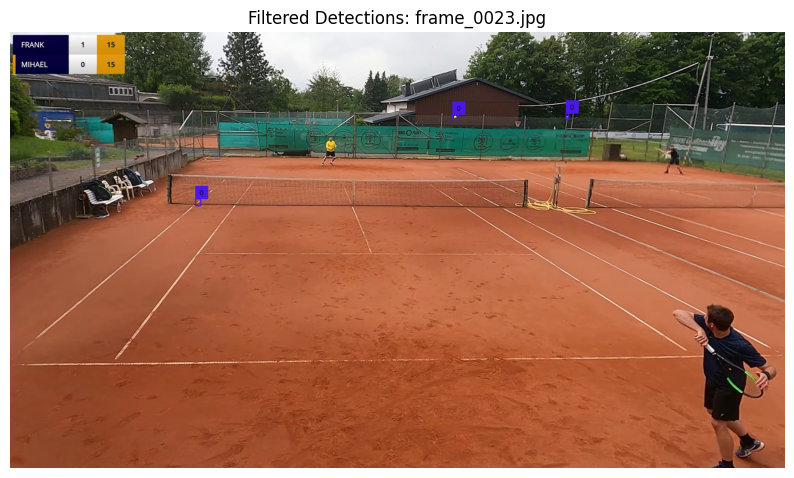


0: 640x640 1 ball, 91.2ms
Speed: 3.4ms preprocess, 91.2ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 47.3ms
Speed: 2.3ms preprocess, 47.3ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 3 balls, 49.4ms
Speed: 2.5ms preprocess, 49.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 balls, 48.7ms
Speed: 2.9ms preprocess, 48.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 49.4ms
Speed: 2.4ms preprocess, 49.4ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 balls, 82.1ms
Speed: 2.4ms preprocess, 82.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 ball, 187.8ms
Speed: 2.6ms preprocess, 187.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 160.3ms
Speed: 2.5ms preprocess, 160.3ms inference, 0.6ms postprocess per image 

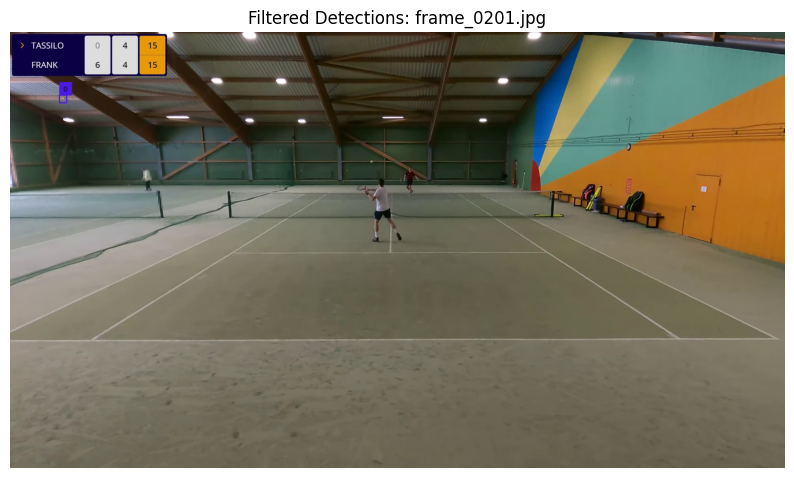


0: 640x640 (no detections), 93.7ms
Speed: 2.6ms preprocess, 93.7ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 70.8ms
Speed: 2.6ms preprocess, 70.8ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 57.9ms
Speed: 3.6ms preprocess, 57.9ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 63.7ms
Speed: 3.7ms preprocess, 63.7ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 65.9ms
Speed: 3.2ms preprocess, 65.9ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 62.6ms
Speed: 2.5ms preprocess, 62.6ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 59.1ms
Speed: 2.6ms preprocess, 59.1ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 55.0ms
Speed: 2.6ms preprocess, 55.0ms i

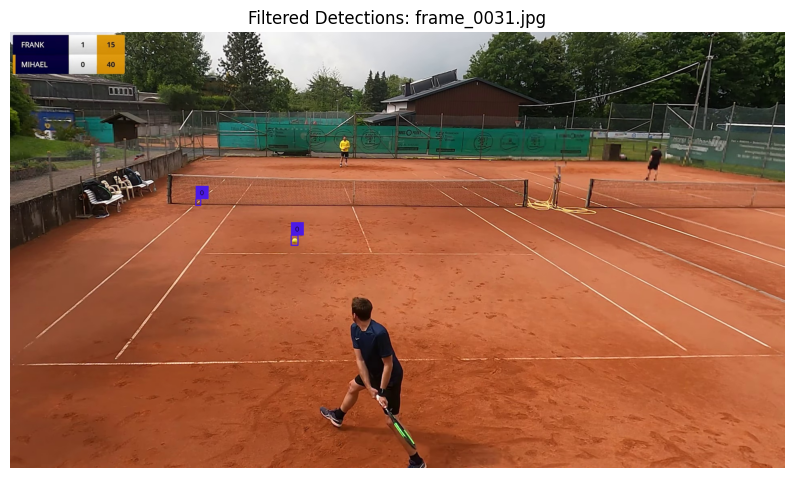


0: 640x640 (no detections), 77.9ms
Speed: 2.9ms preprocess, 77.9ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 54.1ms
Speed: 2.4ms preprocess, 54.1ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 58.6ms
Speed: 3.0ms preprocess, 58.6ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 56.1ms
Speed: 2.4ms preprocess, 56.1ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 player, 55.9ms
Speed: 2.4ms preprocess, 55.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 55.8ms
Speed: 2.3ms preprocess, 55.8ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 player, 51.8ms
Speed: 2.7ms preprocess, 51.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 50.6ms
Speed: 2.3ms preprocess, 50.6ms inference, 0.4m

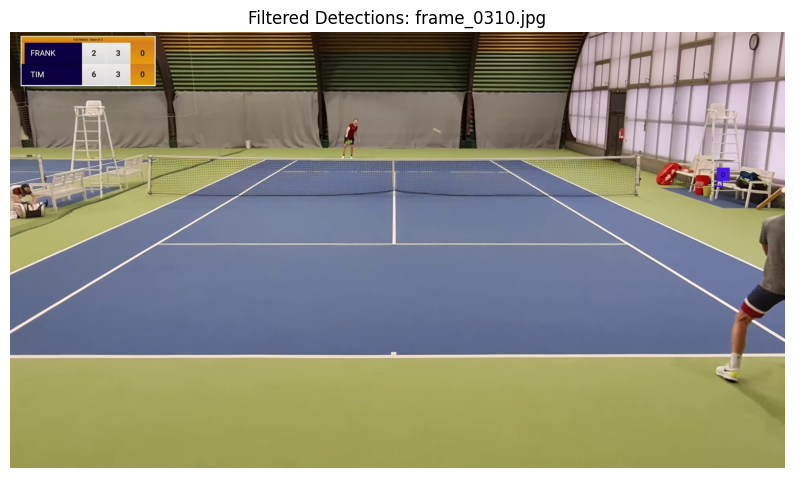


0: 640x640 (no detections), 86.0ms
Speed: 4.1ms preprocess, 86.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 56.6ms
Speed: 2.7ms preprocess, 56.6ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 59.4ms
Speed: 2.5ms preprocess, 59.4ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 58.7ms
Speed: 2.8ms preprocess, 58.7ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 52.7ms
Speed: 2.6ms preprocess, 52.7ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 51.2ms
Speed: 2.4ms preprocess, 51.2ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 50.3ms
Speed: 2.5ms preprocess, 50.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 49.8ms
Speed: 2.5ms preprocess, 49.8ms i

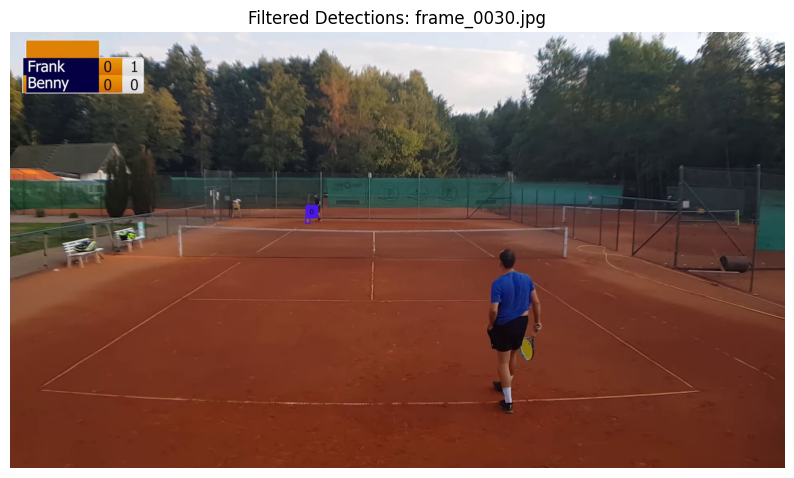


0: 640x640 (no detections), 82.4ms
Speed: 3.1ms preprocess, 82.4ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 52.6ms
Speed: 2.5ms preprocess, 52.6ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 balls, 58.1ms
Speed: 3.3ms preprocess, 58.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 ball, 50.3ms
Speed: 2.5ms preprocess, 50.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 49.7ms
Speed: 2.8ms preprocess, 49.7ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 balls, 51.0ms
Speed: 2.4ms preprocess, 51.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 ball, 51.1ms
Speed: 2.5ms preprocess, 51.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 51.7ms
Speed: 2.4ms preprocess, 51.7ms inference, 0.4ms postprocess per im

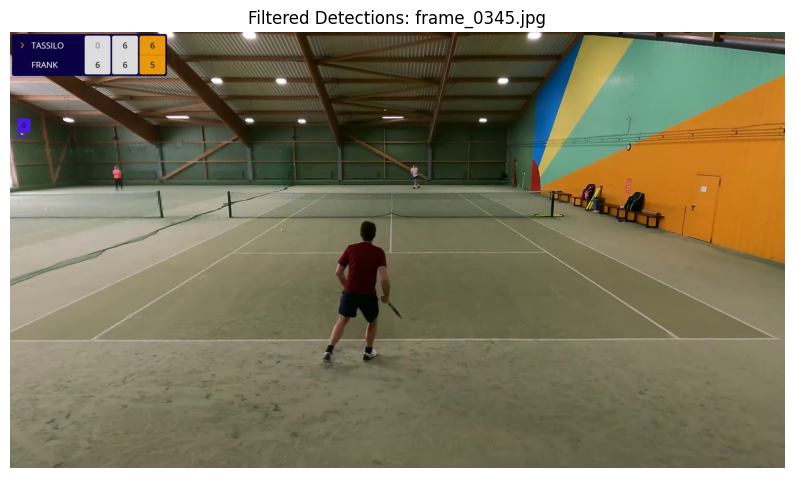


0: 640x640 (no detections), 83.3ms
Speed: 5.9ms preprocess, 83.3ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 48.4ms
Speed: 2.3ms preprocess, 48.4ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 52.0ms
Speed: 2.4ms preprocess, 52.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 49.7ms
Speed: 2.4ms preprocess, 49.7ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 48.6ms
Speed: 2.4ms preprocess, 48.6ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 51.6ms
Speed: 2.5ms preprocess, 51.6ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 49.1ms
Speed: 2.4ms preprocess, 49.1ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 51.4ms
Speed: 2.3ms preprocess, 51.4ms i

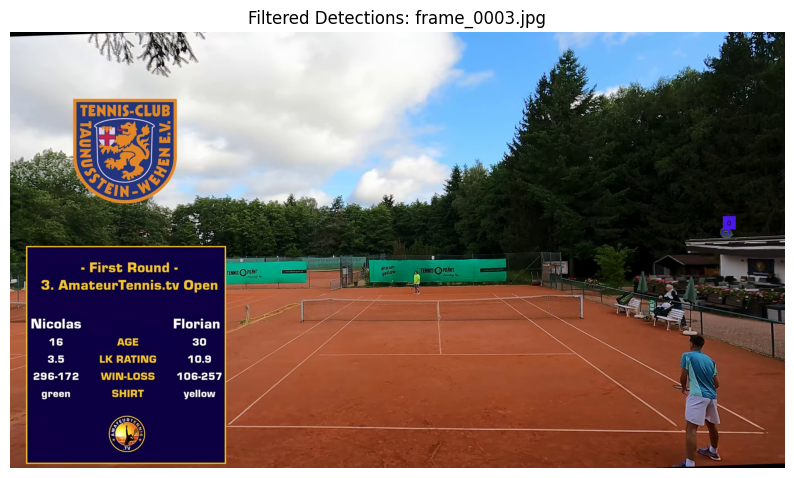


0: 640x640 (no detections), 103.6ms
Speed: 3.5ms preprocess, 103.6ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 54.2ms
Speed: 2.4ms preprocess, 54.2ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 55.8ms
Speed: 2.5ms preprocess, 55.8ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 56.3ms
Speed: 3.2ms preprocess, 56.3ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 56.7ms
Speed: 2.4ms preprocess, 56.7ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 61.7ms
Speed: 2.4ms preprocess, 61.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 55.1ms
Speed: 2.5ms preprocess, 55.1ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 53.9ms
Speed: 2.5ms preprocess, 53.9ms

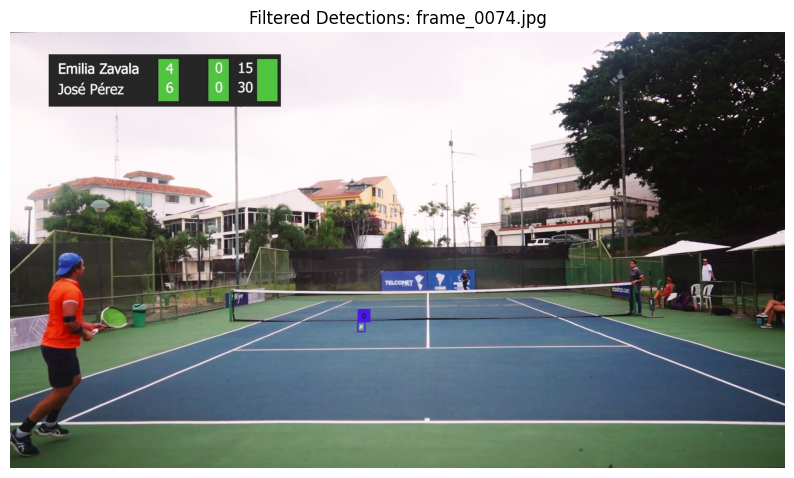


0: 640x640 (no detections), 96.0ms
Speed: 4.2ms preprocess, 96.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 61.0ms
Speed: 2.3ms preprocess, 61.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 59.5ms
Speed: 2.6ms preprocess, 59.5ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 58.9ms
Speed: 2.5ms preprocess, 58.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 59.2ms
Speed: 2.5ms preprocess, 59.2ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 57.2ms
Speed: 2.4ms preprocess, 57.2ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 52.0ms
Speed: 2.7ms preprocess, 52.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 51.2ms
Speed: 2.5ms preprocess, 51.2ms i

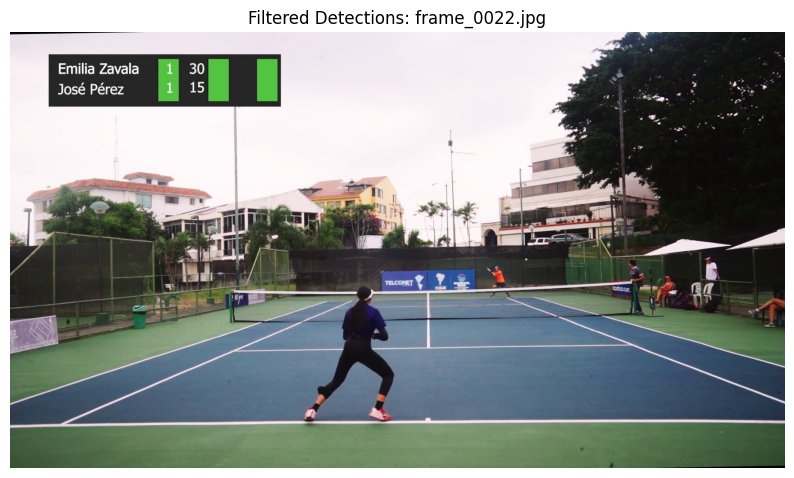


0: 640x640 (no detections), 93.0ms
Speed: 3.6ms preprocess, 93.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 50.0ms
Speed: 2.4ms preprocess, 50.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 49.8ms
Speed: 2.5ms preprocess, 49.8ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 50.9ms
Speed: 2.6ms preprocess, 50.9ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 51.4ms
Speed: 2.6ms preprocess, 51.4ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 51.1ms
Speed: 2.6ms preprocess, 51.1ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 51.8ms
Speed: 2.9ms preprocess, 51.8ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 60.1ms
Speed: 3.2ms preprocess, 60.1ms i

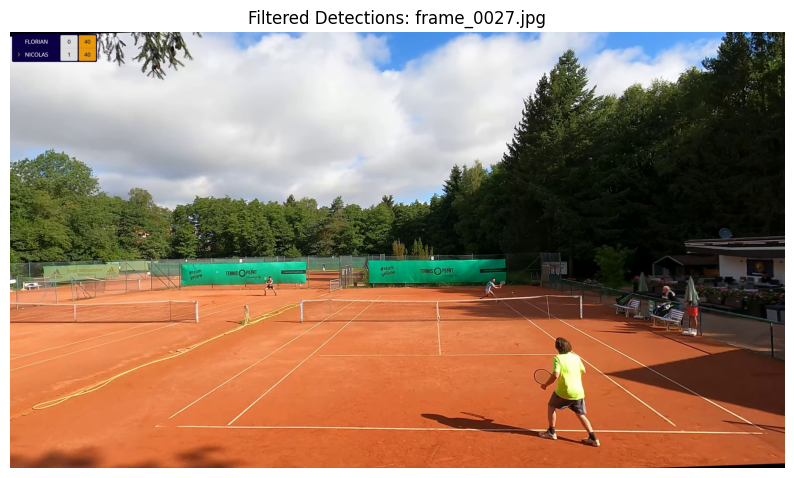

In [31]:
random_imgs = get_random_images(IMAGE_FOLDER, N_IMAGES)
run_inference_on_images(random_imgs, MODEL_PATH, slice_size=(256,256), conf=CONF_THRESHOLD)


# Hyperparameter Tuning for Tennis Ball Detection

In this stage of the project, the goal is to optimize the object detection pipeline by selecting the best combination of hyperparameters. This tuning process is critical to improve the accuracy of tennis ball detection.

To do this, we performed a **grid search** over the following key parameters:

- **`conf_threshold`**: The minimum confidence required for the model to keep a detection. Lower values increase recall but may introduce false positives.
- **`iou_threshold`**: The minimum Intersection over Union (IoU) required to match a predicted bounding box with a ground truth box. It controls how strict the matching is.
- **`inflate_factor`**: A factor that slightly enlarges predicted boxes during evaluation. This helps account for localization errors, especially with small objects like tennis balls.
- **`slice_sizes`**: The dimensions of the sliding windows used to crop the input images. Smaller slices often help detect small objects, but require more computation.

All combinations were tested, and the model was evaluated using **precision, recall, and F1-score**. 


In [27]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from itertools import product
from ultralytics import YOLO
from supervision import Detections
from sklearn.metrics import precision_score, recall_score, f1_score
import pandas as pd

# === GENERAL CONFIGURATION ===
GROUNDTRUTH_FOLDER = "data/val_groundtruth/labels"  # Folder containing YOLO-format label files
IMAGE_FOLDER = "data/val_groundtruth/images"        # Folder containing validation images
MODEL_PATH = "model/model1.pt"                       # Path to the trained YOLOv8 model
BALL_CLASS_ID = 0                                     # Class ID for the tennis ball in YOLO annotations
VISUALIZE = False                                     # Whether to show visual results (disabled for speed)

# === FUNCTION TO READ YOLO ANNOTATIONS ===
def read_yolo_txt(path, image_shape):
    h, w = image_shape
    boxes = []
    if not os.path.exists(path):
        return boxes
    with open(path, "r") as f:
        for line in f:
            parts = line.strip().split()
            if len(parts) != 5:
                continue
            class_id, x_center, y_center, width, height = map(float, parts)
            if int(class_id) == BALL_CLASS_ID:
                # Convert normalized coordinates back to pixel values
                x1 = int((x_center - width / 2) * w)
                y1 = int((y_center - height / 2) * h)
                x2 = int((x_center + width / 2) * w)
                y2 = int((y_center + height / 2) * h)
                boxes.append([x1, y1, x2, y2])
    return boxes

# === FUNCTION TO CALCULATE IOU (Intersection over Union) BETWEEN TWO BOXES ===
def calculate_iou(boxA, boxB):
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])
    interArea = max(0, xB - xA) * max(0, yB - yA)
    if interArea == 0:
        return 0.0
    boxAArea = (boxA[2] - boxA[0]) * (boxA[3] - boxA[1])
    boxBArea = (boxB[2] - boxB[0]) * (boxB[3] - boxB[1])
    return interArea / float(boxAArea + boxBArea - interArea)

# === FUNCTION TO INFLATE A BOUNDING BOX ===
def inflate_box(box, factor=1.5):
    x1, y1, x2, y2 = box
    cx, cy = (x1 + x2) / 2, (y1 + y2) / 2  # Calculate center of the box
    w, h = (x2 - x1) * factor, (y2 - y1) * factor  # Scale width and height
    new_x1 = int(cx - w / 2)
    new_y1 = int(cy - h / 2)
    new_x2 = int(cx + w / 2)
    new_y2 = int(cy + h / 2)
    return [new_x1, new_y1, new_x2, new_y2]

# === FUNCTION TO EVALUATE ONE COMBINATION OF HYPERPARAMETERS ===
def evaluate_combination(model, conf_thres, iou_thres, inflate_factor, slice_sizes):
    all_pred = []  # List of predicted labels
    all_gt = []    # List of ground truth labels
    image_files = [f for f in os.listdir(IMAGE_FOLDER) if f.endswith(".jpg")]

    for file in image_files:
        image_path = os.path.join(IMAGE_FOLDER, file)
        label_path = os.path.join(GROUNDTRUTH_FOLDER, file.replace(".jpg", ".txt"))
        image = cv2.imread(image_path)
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        h_img, w_img = image.shape[:2]
        gt_boxes = read_yolo_txt(label_path, (h_img, w_img))  # Get ground truth boxes

        for slice_w, slice_h in slice_sizes:
            stride_w = int(slice_w * 0.5)  # 50% overlap in sliding window
            stride_h = int(slice_h * 0.5)
            detections_all = []  # Store all detections in full image space

            for y in range(0, h_img, stride_h):
                for x in range(0, w_img, stride_w):
                    x_end = min(x + slice_w, w_img)
                    y_end = min(y + slice_h, h_img)
                    slice_img = image[y:y_end, x:x_end]  # Extract window
                    result = model.predict(slice_img, conf=conf_thres, verbose=False)[0]
                    det = Detections.from_ultralytics(result)

                    # Re-project bounding boxes to original image coordinates
                    det.xyxy[:, [0, 2]] += x
                    det.xyxy[:, [1, 3]] += y

                    for box, cls_id in zip(det.xyxy.astype(int), det.class_id.astype(int)):
                        if cls_id == BALL_CLASS_ID:
                            detections_all.append(box)

            pred_boxes = detections_all
            matched_gt = set()
            matched_pred = set()

            # Match predicted boxes with ground truth using IoU
            for i, gt in enumerate(gt_boxes):
                for j, pred in enumerate(pred_boxes):
                    pred_inflated = inflate_box(pred, factor=inflate_factor)  # Inflate box
                    iou = calculate_iou(gt, pred_inflated)
                    if iou >= iou_thres and j not in matched_pred:
                        matched_gt.add(i)
                        matched_pred.add(j)
                        break

            # Calculate TP, FP, FN
            TP = len(matched_gt)
            FP = len(pred_boxes) - TP
            FN = len(gt_boxes) - TP

            all_pred.extend([1] * TP + [1] * FP)  # 1 for TP and FP
            all_gt.extend([1] * TP + [0] * FP)    # 1 for TP, 0 for FP
            all_pred.extend([0] * FN)             # 0 for FN
            all_gt.extend([1] * FN)               # 1 for FN

    # Calculate metrics
    precision = precision_score(all_gt, all_pred, zero_division=0)
    recall = recall_score(all_gt, all_pred, zero_division=0)
    f1 = f1_score(all_gt, all_pred, zero_division=0)
    return precision, recall, f1


In [30]:

# === GRID SEARCH OVER HYPERPARAMETERS ===
conf_thresholds = [0.2, 0.3, 0.4]       # Confidence thresholds
iou_thresholds = [0.3, 0.4, 0.5]        # IoU thresholds
inflate_factors = [1.2, 1.5, 1.8]       # Bounding box inflation factors
slice_combinations = [                 # Sliding window slice sizes
    [(256, 256)],
    [(384, 384)],
    [(512, 512)],
]

model = YOLO(MODEL_PATH)  # Load YOLO model
results = []              # Store results of each configuration

# Iterate over all combinations of hyperparameters
for conf, iou, inflate, slices in product(conf_thresholds, iou_thresholds, inflate_factors, slice_combinations):
    print(f"Evaluating: CONF={conf}, IOU={iou}, INFLATE={inflate}, SLICES={slices}")
    precision, recall, f1 = evaluate_combination(model, conf, iou, inflate, slices)
    results.append({
        "conf_threshold": conf,
        "iou_threshold": iou,
        "inflate_factor": inflate,
        "slice_sizes": str(slices),
        "precision": precision,
        "recall": recall,
        "f1_score": f1
    })

# === DISPLAY RESULTS ===
df = pd.DataFrame(results)  # Convert results to a DataFrame
df_sorted = df.sort_values(by="f1_score", ascending=False)  # Sort by F1-score
print("\n🔝 Top Combinations Sorted by F1-score:")
print(df_sorted.head(10))  # Display top 10 results

Evaluating: CONF=0.2, IOU=0.3, INFLATE=1.2, SLICES=[(256, 256)]
Evaluating: CONF=0.2, IOU=0.3, INFLATE=1.2, SLICES=[(384, 384)]
Evaluating: CONF=0.2, IOU=0.3, INFLATE=1.2, SLICES=[(512, 512)]
Evaluating: CONF=0.2, IOU=0.3, INFLATE=1.5, SLICES=[(256, 256)]
Evaluating: CONF=0.2, IOU=0.3, INFLATE=1.5, SLICES=[(384, 384)]
Evaluating: CONF=0.2, IOU=0.3, INFLATE=1.5, SLICES=[(512, 512)]
Evaluating: CONF=0.2, IOU=0.3, INFLATE=1.8, SLICES=[(256, 256)]
Evaluating: CONF=0.2, IOU=0.3, INFLATE=1.8, SLICES=[(384, 384)]
Evaluating: CONF=0.2, IOU=0.3, INFLATE=1.8, SLICES=[(512, 512)]
Evaluating: CONF=0.2, IOU=0.4, INFLATE=1.2, SLICES=[(256, 256)]
Evaluating: CONF=0.2, IOU=0.4, INFLATE=1.2, SLICES=[(384, 384)]
Evaluating: CONF=0.2, IOU=0.4, INFLATE=1.2, SLICES=[(512, 512)]
Evaluating: CONF=0.2, IOU=0.4, INFLATE=1.5, SLICES=[(256, 256)]
Evaluating: CONF=0.2, IOU=0.4, INFLATE=1.5, SLICES=[(384, 384)]
Evaluating: CONF=0.2, IOU=0.4, INFLATE=1.5, SLICES=[(512, 512)]
Evaluating: CONF=0.2, IOU=0.4, INFLATE=1

In [31]:
best = df_sorted.iloc[0]

print("\nEvaluated combinations (sorted by F1-score):")
print(df_sorted[['conf_threshold', 'iou_threshold', 'inflate_factor', 'slice_sizes', 'precision', 'recall', 'f1_score']].head(20))  # or all

print(f"\nBest combination:\nCONF = {best['conf_threshold']}, IOU = {best['iou_threshold']}, INFLATE = {best['inflate_factor']}, SLICES = {best['slice_sizes']}")



Evaluated combinations (sorted by F1-score):
    conf_threshold  iou_threshold  inflate_factor   slice_sizes  precision  \
2              0.2            0.3             1.2  [(512, 512)]   0.315789   
5              0.2            0.3             1.5  [(512, 512)]   0.315789   
11             0.2            0.4             1.2  [(512, 512)]   0.315789   
39             0.3            0.4             1.5  [(256, 256)]   0.230769   
36             0.3            0.4             1.2  [(256, 256)]   0.230769   
33             0.3            0.3             1.8  [(256, 256)]   0.230769   
30             0.3            0.3             1.5  [(256, 256)]   0.230769   
27             0.3            0.3             1.2  [(256, 256)]   0.230769   
20             0.2            0.5             1.2  [(512, 512)]   0.263158   
8              0.2            0.3             1.8  [(512, 512)]   0.263158   
14             0.2            0.4             1.5  [(512, 512)]   0.263158   
13             0.2

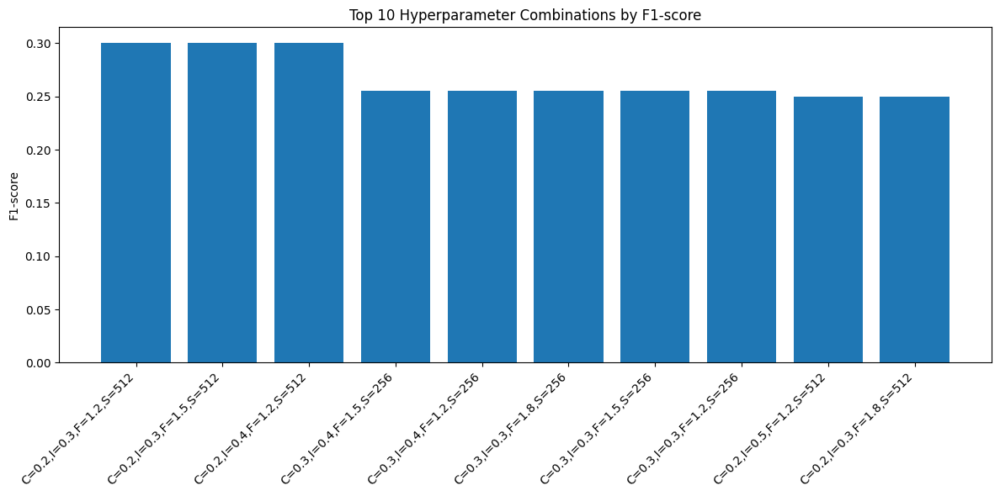

In [32]:
import matplotlib.pyplot as plt

# Get the top 10 hyperparameter combinations based on F1-score
top = df_sorted.head(10)

# Create combined labels for the x-axis (Conf, IoU, Inflate, SliceSize)
# Example: "C=0.2,I=0.3,F=1.2,S=512"
labels = [
    f"C={row['conf_threshold']},I={row['iou_threshold']},F={row['inflate_factor']},S={eval(row['slice_sizes'])[0][0]}"
    for _, row in top.iterrows()
]
# Initialize the figure
plt.figure(figsize=(12, 6))
# Create a bar plot showing F1-scores for the top combinations
plt.bar(labels, top['f1_score'])
# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')
# Add a title and y-axis label
plt.title("Top 10 Hyperparameter Combinations by F1-score")
plt.ylabel("F1-score")
# Adjust layout so labels and title don't overlap
plt.tight_layout()
# Display the plot
plt.show()


Finally, the best-performing combination based on F1-score was:  
 **CONF = 0.2, IOU = 0.3, INFLATE = 1.2, SLICES = (512, 512)**

This combination achieves the most balanced performance in detecting tennis balls accurately while minimizing both false positives and false negatives.

### Why is this combination the best?

- **Low confidence threshold (0.2)**: Ensures the model doesn’t miss weak detections of small tennis balls, increasing recall.
- **Moderate IoU threshold (0.3)**: Allows for some tolerance in matching predictions with ground truth, helpful when bounding boxes aren't perfectly aligned.
- **Slight inflation (1.2)**: Expands predicted boxes slightly, improving chances of overlap with the ground truth — especially useful for small objects.
- **Larger slice size (512x512)**: Reduces the number of cuts needed while still keeping balls in view. This avoids edge artifacts that might cause missed detections in smaller slices.

This tuned configuration offers a strong trade-off between accuracy and efficiency for tennis ball detection in amateur match settings.


### Step 4: Visual Validation with Ground Truth

The **next step** involves testing the **best combination of hyperparameters** —  
**confidence threshold**, **IoU threshold**, **inflate factor**, and **slice size** —  
on the **15 validation images** that contain manually labeled **ground truth annotations**.

The selected combination, based on the highest **F1-score**, is:  
**CONF = 0.2, IOU = 0.3, INFLATE = 1.2, SLICES = (512, 512)**.

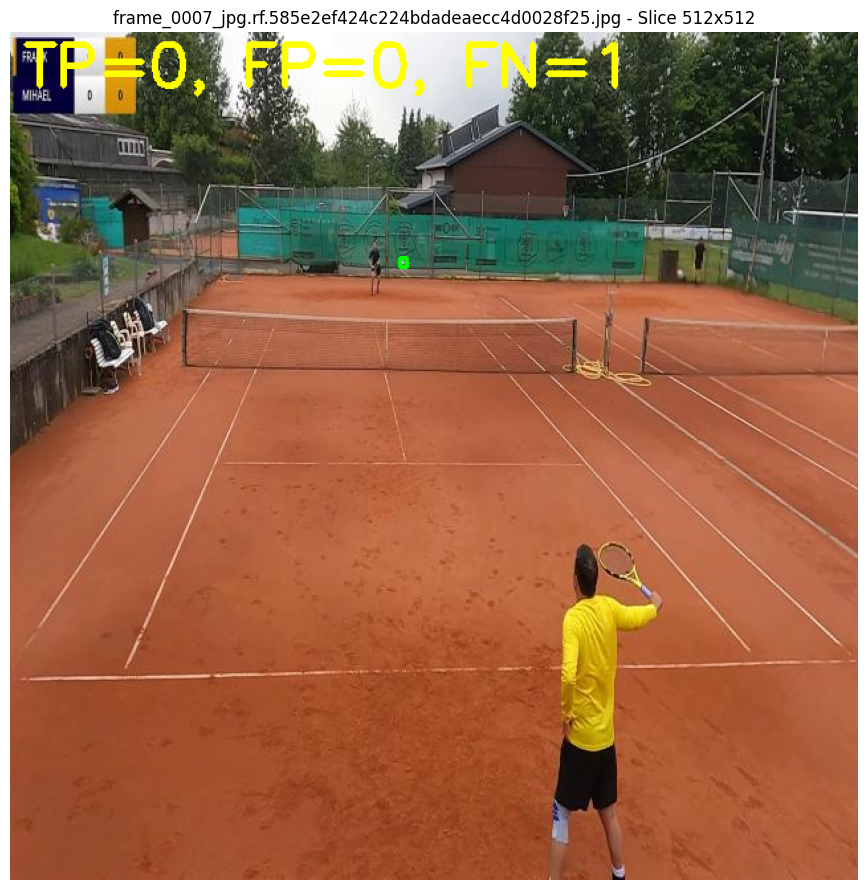

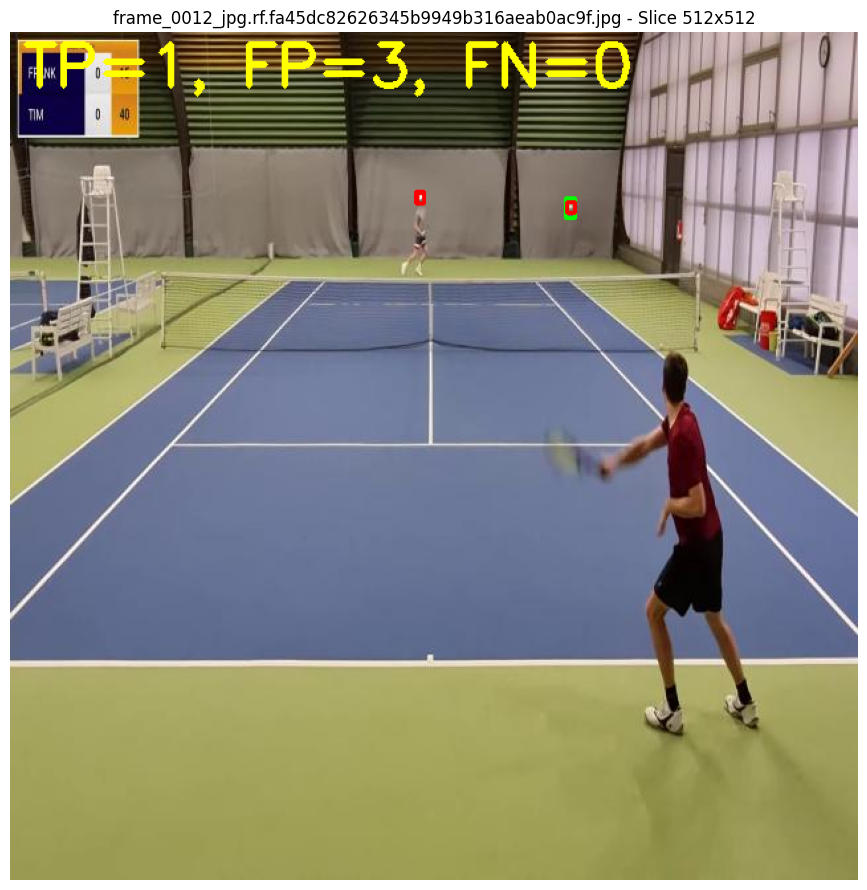

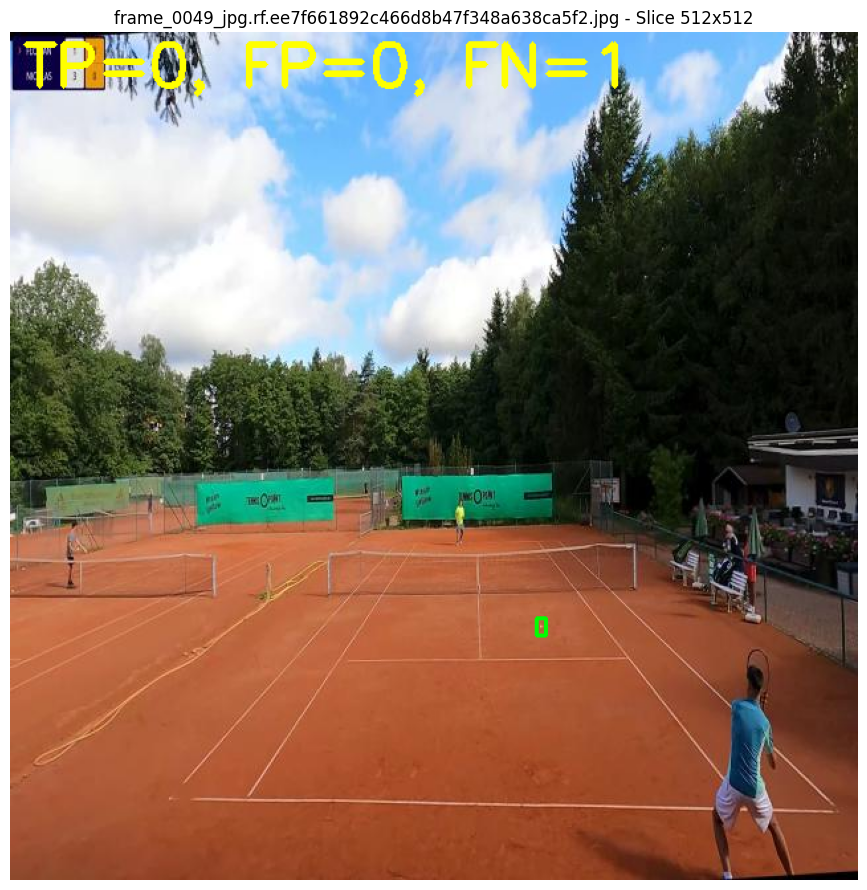

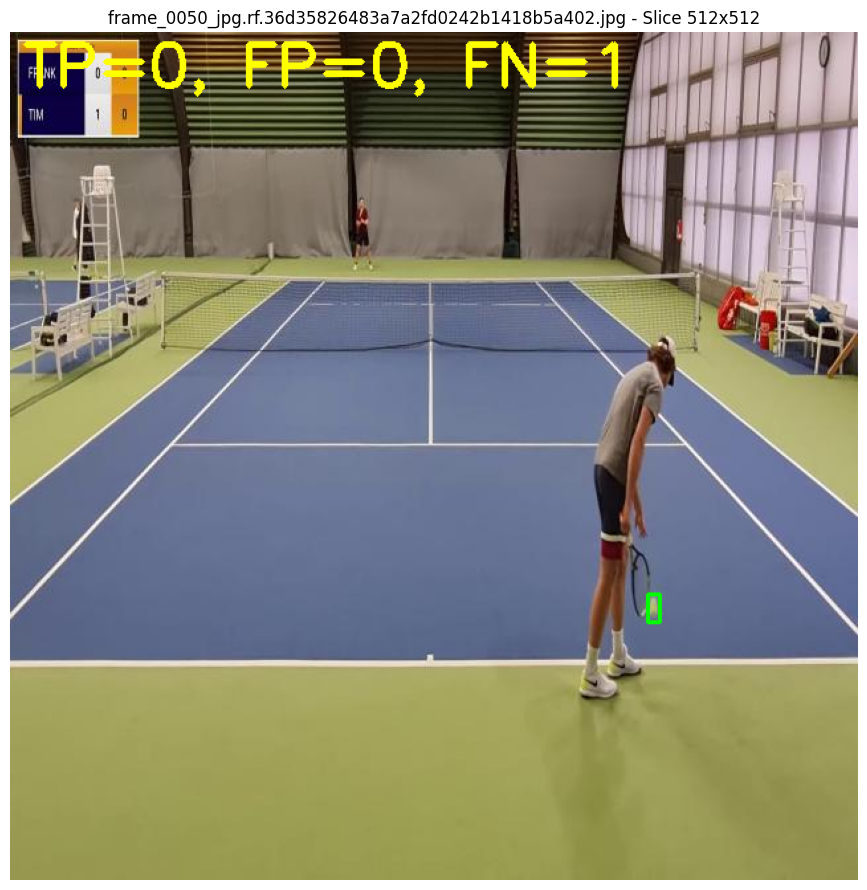

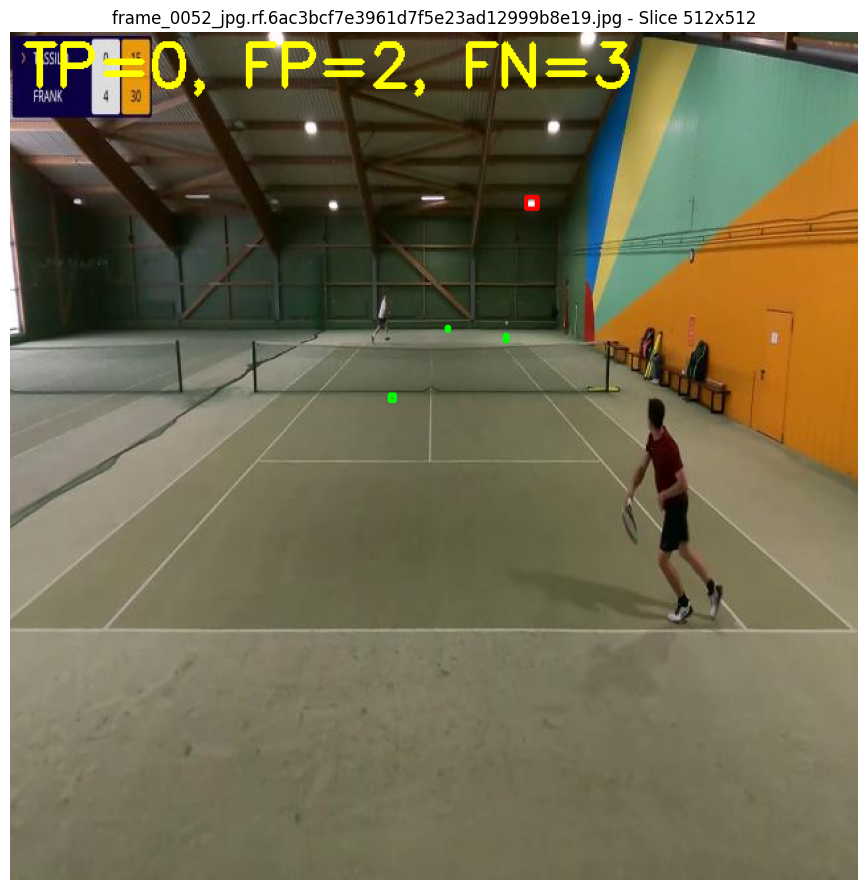

...

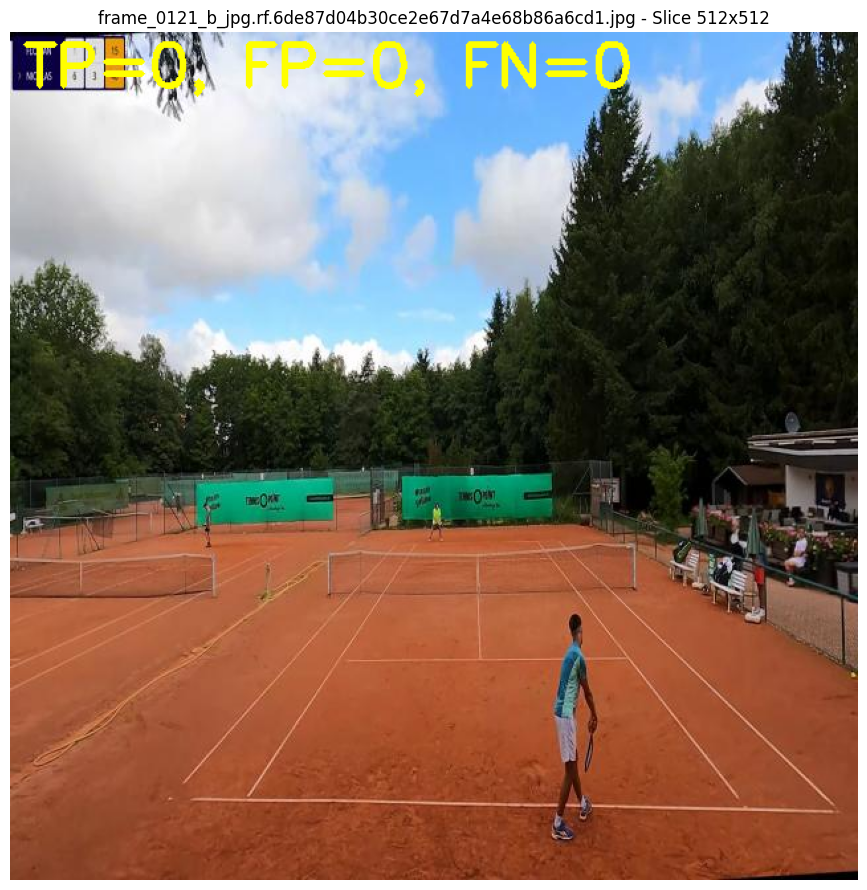

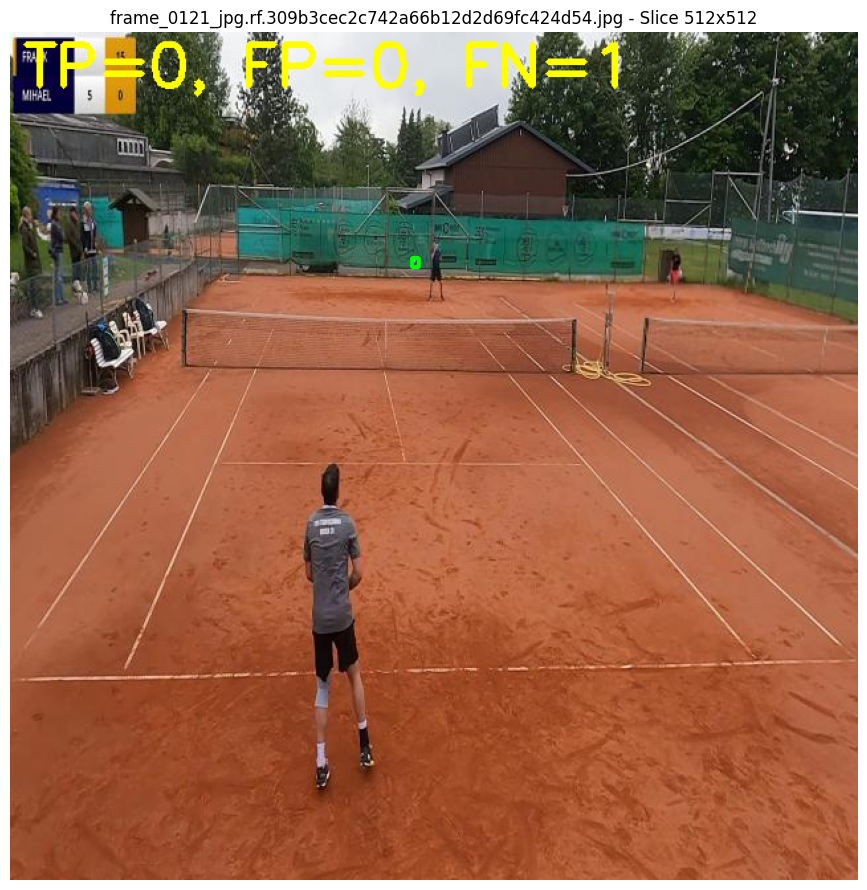

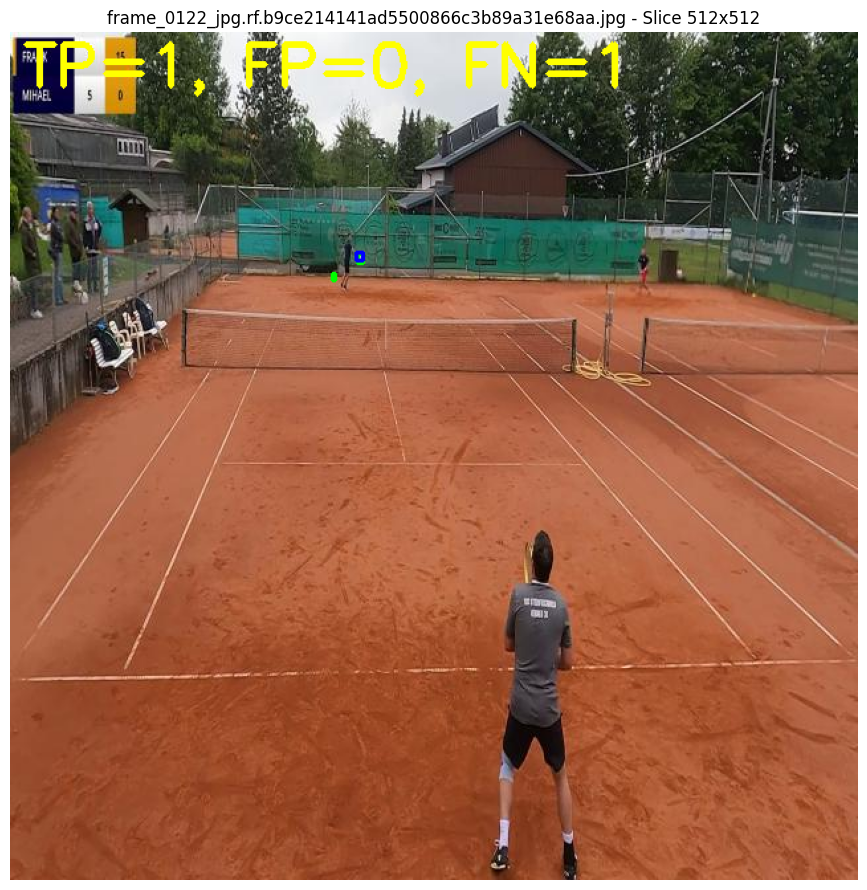

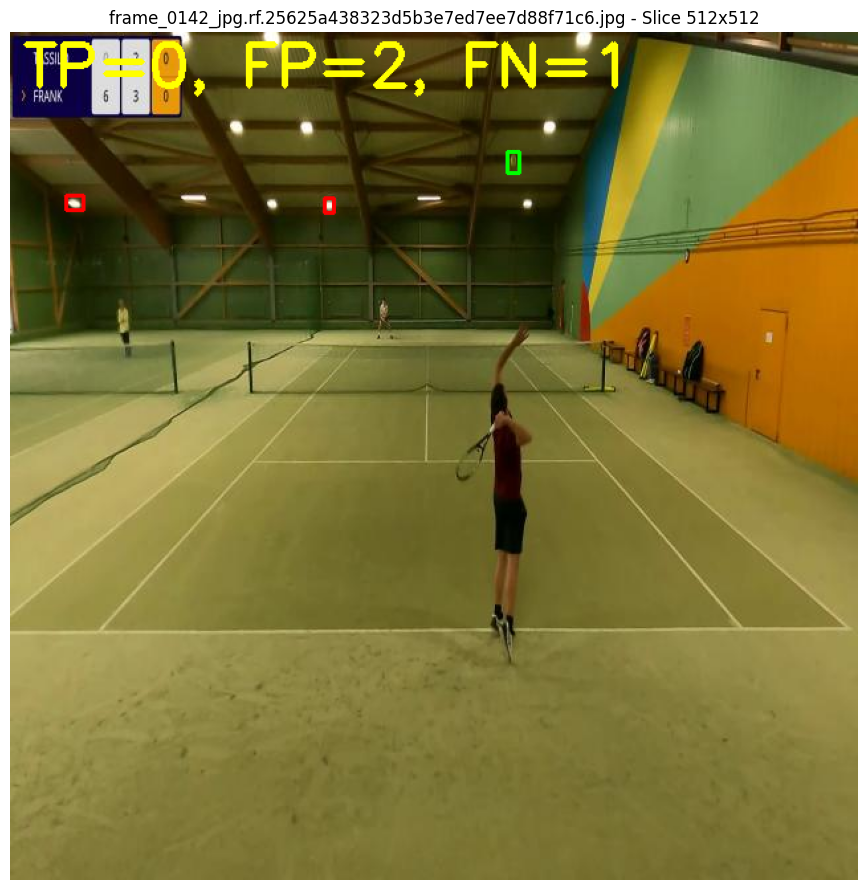

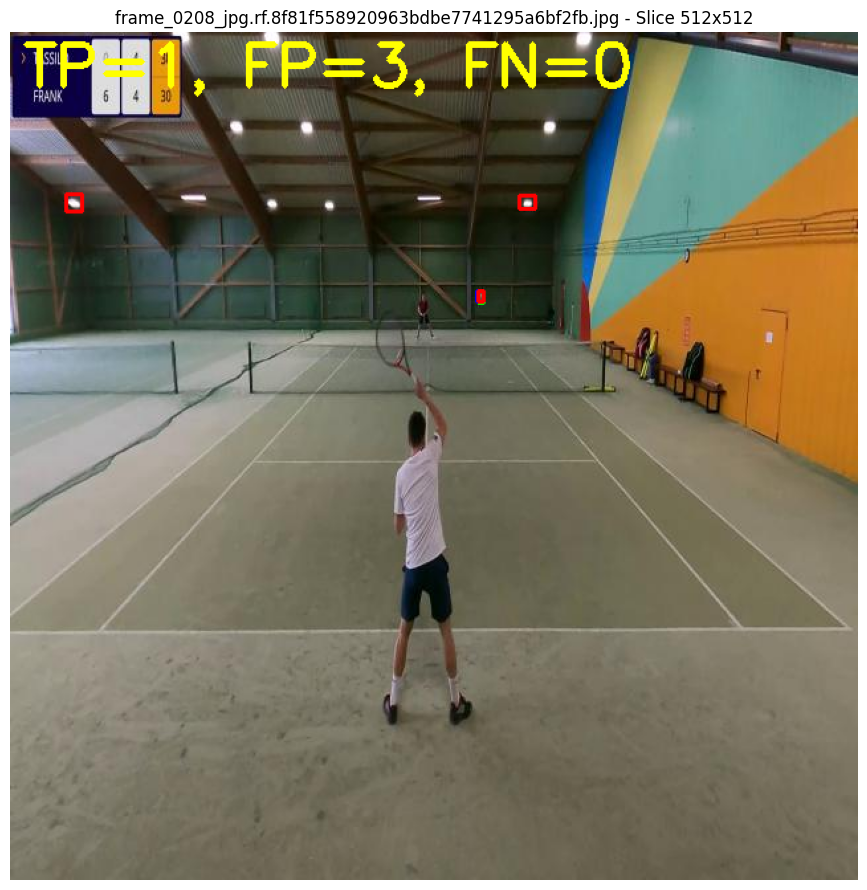

In [33]:
# -*- coding: utf-8 -*-

import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from ultralytics import YOLO
from supervision import Detections
from sklearn.metrics import precision_score, recall_score, f1_score

# === CONFIGURATION SECTION ===
# Paths to ground truth labels and images
GROUNDTRUTH_FOLDER = "data/val_groundtruth/labels"
IMAGE_FOLDER = "data/val_groundtruth/images"
# Path to the trained YOLOv8 model
MODEL_PATH = "model/model1.pt"

# Evaluation hyperparameters
IOU_THRESHOLD = 0.3               # Minimum IoU to count as True Positive
CONF_THRESHOLD = 0.2             # Minimum confidence for detection to be considered
SLICE_SIZES = [(512, 512)]       # List of slice sizes for tiled inference
STRIDE_RATIO = 0.5               # Percentage of overlap between slices
BALL_CLASS_ID = 0                # Class ID corresponding to the tennis ball
INFLATE_FACTOR = 1.2             # Factor to enlarge predicted boxes during matching

# === Function to read YOLO-format annotations and convert them to pixel coordinates ===
def read_yolo_txt(path, image_shape):
    h, w = image_shape
    boxes = []
    if not os.path.exists(path):
        return boxes
    with open(path, "r") as f:
        for line in f:
            parts = line.strip().split()
            if len(parts) != 5:
                continue
            class_id, x_center, y_center, width, height = map(float, parts)
            if int(class_id) == BALL_CLASS_ID:
                x1 = int((x_center - width / 2) * w)
                y1 = int((y_center - height / 2) * h)
                x2 = int((x_center + width / 2) * w)
                y2 = int((y_center + height / 2) * h)
                boxes.append([x1, y1, x2, y2])
    return boxes

# === Function to compute Intersection over Union (IoU) between two boxes ===
def calculate_iou(boxA, boxB):
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])
    interArea = max(0, xB - xA) * max(0, yB - yA)
    if interArea == 0:
        return 0.0
    boxAArea = (boxA[2] - boxA[0]) * (boxA[3] - boxA[1])
    boxBArea = (boxB[2] - boxB[0]) * (boxB[3] - boxB[1])
    return interArea / float(boxAArea + boxBArea - interArea)

# === Inflate predicted boxes slightly to be more tolerant in evaluation ===
def inflate_box(box, factor=1.2):
    x1, y1, x2, y2 = box
    cx, cy = (x1 + x2) / 2, (y1 + y2) / 2
    w, h = (x2 - x1) * factor, (y2 - y1) * factor
    new_x1 = int(cx - w / 2)
    new_y1 = int(cy - h / 2)
    new_x2 = int(cx + w / 2)
    new_y2 = int(cy + h / 2)
    return [new_x1, new_y1, new_x2, new_y2]

# === Main evaluation function with visual output ===
def evaluate_with_visuals(model):
    image_files = [f for f in os.listdir(IMAGE_FOLDER) if f.endswith(".jpg")]
    for file in image_files:
        image_path = os.path.join(IMAGE_FOLDER, file)
        label_path = os.path.join(GROUNDTRUTH_FOLDER, file.replace(".jpg", ".txt"))
        image = cv2.imread(image_path)
        h_img, w_img = image.shape[:2]
        gt_boxes = read_yolo_txt(label_path, (h_img, w_img))

        for slice_w, slice_h in SLICE_SIZES:
            stride_w = int(slice_w * STRIDE_RATIO)
            stride_h = int(slice_h * STRIDE_RATIO)
            detections_all = []

            # Slide window across image
            for y in range(0, h_img, stride_h):
                for x in range(0, w_img, stride_w):
                    x_end = min(x + slice_w, w_img)
                    y_end = min(y + slice_h, h_img)
                    slice_img = image[y:y_end, x:x_end]
                    result = model.predict(slice_img, conf=CONF_THRESHOLD, verbose=False)[0]
                    det = Detections.from_ultralytics(result)

                    # Re-map detection coordinates to full image
                    det.xyxy[:, [0, 2]] += x
                    det.xyxy[:, [1, 3]] += y

                    # Collect boxes for tennis ball class
                    for box, cls_id in zip(det.xyxy.astype(int), det.class_id.astype(int)):
                        if cls_id == BALL_CLASS_ID:
                            detections_all.append(box)

            pred_boxes = detections_all
            matched_gt = set()
            matched_pred = set()

            # Match predictions to ground truth
            for i, gt in enumerate(gt_boxes):
                for j, pred in enumerate(pred_boxes):
                    pred_inflated = inflate_box(pred, factor=INFLATE_FACTOR)
                    iou = calculate_iou(gt, pred_inflated)
                    if iou >= IOU_THRESHOLD and j not in matched_pred:
                        matched_gt.add(i)
                        matched_pred.add(j)
                        break

            # Compute metrics
            TP = len(matched_gt)
            FP = len(pred_boxes) - TP
            FN = len(gt_boxes) - TP

            # Draw results
            vis = image.copy()
            for box in gt_boxes:
                cv2.rectangle(vis, (box[0], box[1]), (box[2], box[3]), (0, 255, 0), 2)  # Green = GT
            for idx, box in enumerate(pred_boxes):
                color = (255, 0, 0) if idx in matched_pred else (0, 0, 255)  # Blue = TP, Red = FP
                cv2.rectangle(vis, (box[0], box[1]), (box[2], box[3]), color, 2)
            cv2.putText(vis, f"TP={TP}, FP={FP}, FN={FN}", (10, 40),
                        cv2.FONT_HERSHEY_SIMPLEX, 1.5, (0, 255, 255), 3)

            # Show annotated image
            plt.figure(figsize=(13, 9))
            plt.imshow(cv2.cvtColor(vis, cv2.COLOR_BGR2RGB))
            plt.title(f"{file} - Slice {slice_w}x{slice_h}")
            plt.axis("off")
            plt.tight_layout()
            plt.show()

# === Load model and run visual evaluation ===
model = YOLO(MODEL_PATH)
evaluate_with_visuals(model)
